# Lab Assignment 2 - Scott Souter

## Student ID - 200017121

#### GitHub Repository URL: https://github.com/scottsouter/PY4SA23_Assignment

## Python Basics

Task 1: Create an If...Else statement that will test whether a number is divisible by three. "YOUR VALUE is divisible by 3" should be printed if the value is divisible by three. "YOUR VALUE is not divisible by three" should be printed if it is not divisible by three. Test the statement on a numeric variable. Upper case text in the print statement should be replaced with the tested number.

In [78]:
x = input("What is your input?")

if float (x) %3 == 0:
    print(str(x) + " is divisible by 3.")
else:
    print(str(x) + " is not divisible by 3.")

What is your input? 5


5 is not divisible by 3.


T2: Create an If...Else statement that will test whether a type of fruit, represented as a text string, is in a list of acceptable fruits (apple, orange, pear, kiwi, or strawberry). If the fruit is on the list, the following should be printed: "YOUR FRUIT is acceptable." If not, then the following should be printed: "YOUR FRUIT is not acceptable." Upper case text in the print statement should be replaced with the tested fruit.

In [15]:
fruit_list = ['apple', 'orange', 'pear', 'kiwi', 'strawberry']

fruit = str(input('Enter the fruit you want to select'))

if fruit in fruit_list:
    print('fruit is acceptable')
else:
    print('fruit is not acceptable')

Enter the fruit you want to select apple


fruit is acceptable


T3: Create a function to calculate the distance between two coordinates using the haversine formula. Write the following formula where the input parameters are a pair of coordinates as two lists.

In [84]:
lon1 = input("Enter the longitiude of origin")
lat1 = input("Enter the latitiude of origin")
lon2 = input("Enter the longitiude of destination")
lat2 = input("Enter the latitude of destination")

from math import radians, cos, sin, asin, sqrt

def haversine(lon1, lat1, lon2, lat2):
    
    R = 6371
    
    dlat = radians(float(lat2) - float(lat1))
    dlon = radians(float(lon2) - float(lon1))
    lat1 = radians(float(lat1))
    lat2 = radians(float(lat2))
    
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a))
    
    return R * c

Answer = (haversine(lat1, lon1, lat2, lon2))

print("The distance between these two points is " + str(Answer) + " kilometres.")

Enter the longitiude of origin 2
Enter the latitiude of origin 3
Enter the longitiude of destination 4
Enter the latitude of destination 5


The distance between these two points is 314.28325507368385 kilometres.


## Pandas and NumPy

**Question 1: How many trees are of the Quercus or Acer genus?**

In [137]:
import numpy as np
import pandas as pd

park_trees_df = pd.read_csv('portland_park_trees.csv')
subQuerusAcer = park_trees_df[(park_trees_df["Genus"]=="Quercus") + (park_trees_df["Genus"]=="Acer")]
print(len(subQuerusAcer))

5675


**Q2: How many trees are of the Quercus or Acer genus and have a DBH larger than 50 inches?**

In [138]:
QuAcfifty = subQuerusAcer[subQuerusAcer["DBH"]>50]
print(len(QuAcfifty))

124


**Q3: Which genus has the highest mean DBH of the following genera: Quercus, Acer, or Fraxinus?**

In [139]:
tree_data = pd.DataFrame()
tree_data["Mean"] = park_trees_df.groupby("Genus")["DBH"].mean()
tree_data

,Mean
Genus,
Abies,20.281169
Acer,18.419085
Aesculus,28.691304
Ailanthus,16.978571
Albizia,7.340000
...,...
Unknown,11.195833
Viburnum,8.300000
Xanthocyparis,5.051852


* Quercus has the highest mean DBH

**Q4: How many different species of trees are recorded in the Acer genus?**

In [200]:
Species_tree = (park_trees_df[["Species", "Genus"]])
Species_tree
AcerSpecies = Species_tree[(Species_tree["Genus"]=="Acer")]
AcerSpecies
AcerSpecies["Species"].nunique()

20

**Question 5**

**Calculate a new column named "pop_M" (population in millions), by transforming the "pop" (population) column.**

In [112]:
cities_df = pd.read_csv('world_cities.csv')

In [181]:
cities_df["pop_M"] = cities_df["pop"] / 1000000 # new column 
cities_df                             

,city,country,pop,lat,lon,capital,pop_M
0,'Abasan al-Jadidah,Palestine,5629,31.31,34.34,0,0.005629
1,'Abasan al-Kabirah,Palestine,18999,31.32,34.35,0,0.018999
2,'Abdul Hakim,Pakistan,47788,30.55,72.11,0,0.047788
3,'Abdullah-as-Salam,Kuwait,21817,29.36,47.98,0,0.021817
4,'Abud,Palestine,2456,32.03,35.07,0,0.002456
...,...,...,...,...,...,...,...
43640,az-Zubayr,Iraq,124611,30.39,47.71,0,0.124611
43641,az-Zulfi,Saudi Arabia,54070,26.30,44.80,0,0.054070
43642,az-Zuwaytinah,Libya,21984,30.95,20.12,0,0.021984
43643,s-Gravenhage,Netherlands,479525,52.07,4.30,0,0.479525


**Remove the original "pop" column.**

In [172]:
subset_query = cities_df.query("pop_M > 0")[["city", "country", "lat", "lon", "capital", "pop_M"]]
subset_query

,city,country,lat,lon,capital,pop_M
0,'Abasan al-Jadidah,Palestine,31.31,34.34,0,0.005629
1,'Abasan al-Kabirah,Palestine,31.32,34.35,0,0.018999
2,'Abdul Hakim,Pakistan,30.55,72.11,0,0.047788
3,'Abdullah-as-Salam,Kuwait,29.36,47.98,0,0.021817
4,'Abud,Palestine,32.03,35.07,0,0.002456
...,...,...,...,...,...,...
43640,az-Zubayr,Iraq,30.39,47.71,0,0.124611
43641,az-Zulfi,Saudi Arabia,26.30,44.80,0,0.054070
43642,az-Zuwaytinah,Libya,30.95,20.12,0,0.021984
43643,s-Gravenhage,Netherlands,52.07,4.30,0,0.479525


**Choose/subset a city that starts with the same letter as your first name (for example, "Mexico City" if your first name is Michael).**

In [118]:
subset_query[subset_query["city"].str.startswith("S")]

,city,country,lat,lon,capital,pop_M
27919,San Antonio de Pale,Equatorial Guinea,-1.41,5.61,0,0.004279
31942,Sa Dec,Vietnam,10.30,105.76,0,0.061430
31943,Sa Kaeo,Thailand,13.82,102.07,0,0.029821
31944,Sa'abat,Algeria,36.63,3.70,0,0.019440
31945,Sa'idah,Algeria,34.84,0.14,0,0.129821
...,...,...,...,...,...,...
36897,Szprotawa,Poland,51.57,15.52,0,0.012760
36898,Sztum,Poland,53.85,18.96,0,0.010022
36899,Szubin,Poland,53.01,17.72,0,0.009145
36900,Szurdokpuspoki,Hungary,47.86,19.70,0,0.001937


**Subset the five biggest (i.e., largest population sizes) cities from the country where your selected city is.**

In [170]:
Poland_subset = subset_query[subset_query["country"] == "Poland"]
Poland_subset

Poland_pop = Poland_subset.sort_values(by="pop_M").tail()
Poland_pop

,city,country,lat,lon,capital,pop_M
29756,Poznan,Poland,52.40,16.90,0,0.567957
41895,Wroclaw,Poland,51.11,17.03,0,0.633276
8382,Cracow,Poland,50.06,19.96,0,0.753829
21253,Lodz,Poland,51.77,19.46,0,0.762615
41441,Warsaw,Poland,52.26,21.02,1,1.634441


**Print the result**

In [171]:
Poland_fivebiggest = Poland_pop[Poland_pop["pop_M"]>0.567956]
Poland_fivebiggest                                

,city,country,lat,lon,capital,pop_M
29756,Poznan,Poland,52.40,16.90,0,0.567957
41895,Wroclaw,Poland,51.11,17.03,0,0.633276
8382,Cracow,Poland,50.06,19.96,0,0.753829
21253,Lodz,Poland,51.77,19.46,0,0.762615
41441,Warsaw,Poland,52.26,21.02,1,1.634441


## Python Data Visualization

**Graph 1: Create a scatterplot for just trees in the Ulmus genus with DBH mapped to the x-axis and tree height mapped to the y-axis (Hint: You will need to use the “Genus”, “DBH”, and “TreeHeight” attributes.).**

<AxesSubplot: xlabel='DBH', ylabel='TreeHeight'>

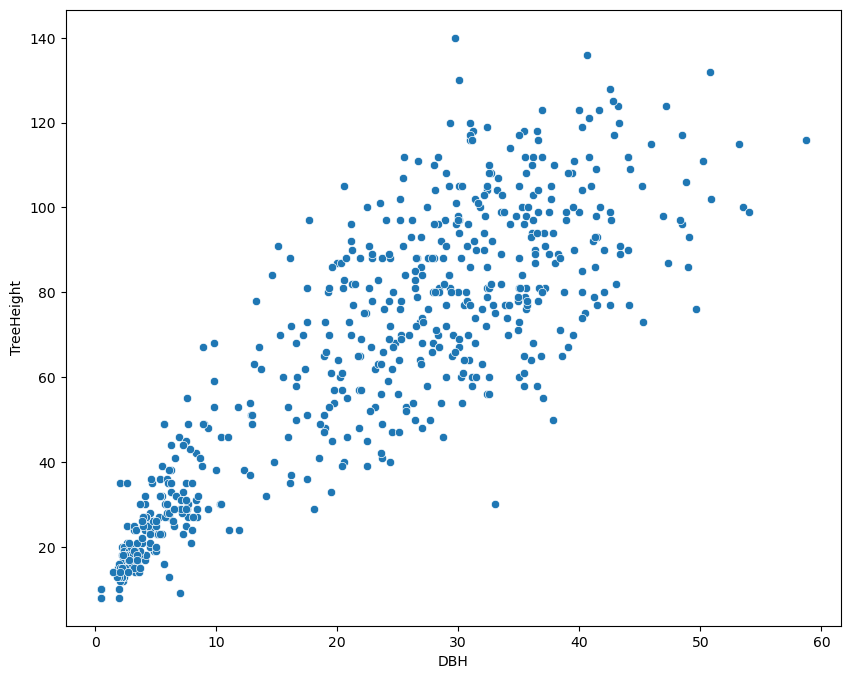

In [18]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.scatterplot(data=park_trees_df.loc[park_trees_df["Genus"]=="Ulmus"], x='DBH', y='TreeHeight')

**G2: Create a scatterplot for just trees in the Ulmus genus with DBH mapped to the x-axis, tree height mapped to the y-axis, and tree species mapped to hue (Hint: You will need to use the “Genus”, “Genus_spec”, “DBH”, and “TreeHeight” attributes.)**

<AxesSubplot: xlabel='DBH', ylabel='TreeHeight'>

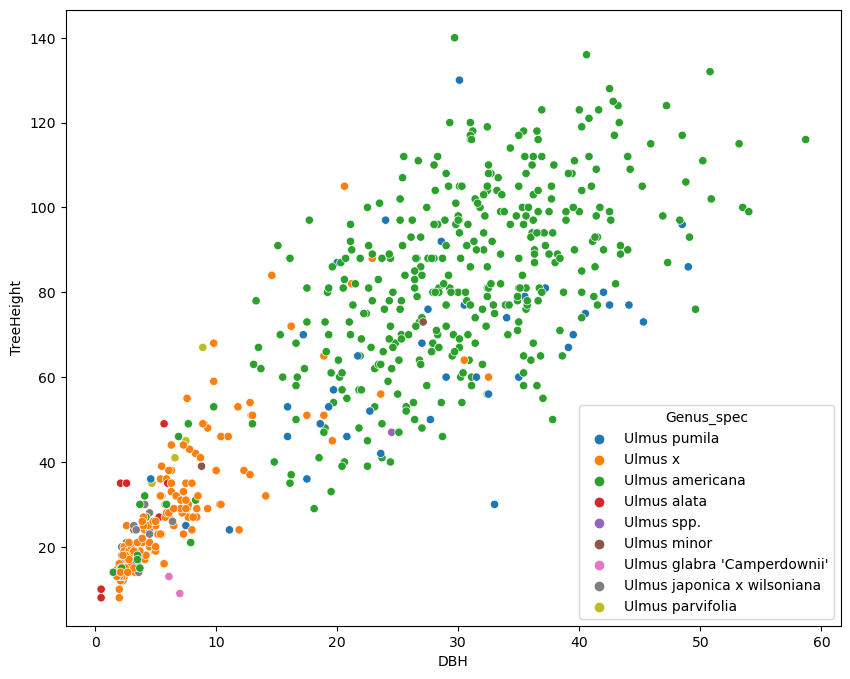

In [19]:
sns.scatterplot(data=park_trees_df.loc[park_trees_df["Genus"]=="Ulmus"], x='DBH', y='TreeHeight', hue='Genus_spec')

**G3: Create a boxplot of DBH for just the Ulmus genus differentiated by species (or, each species should have its own boxplot).**

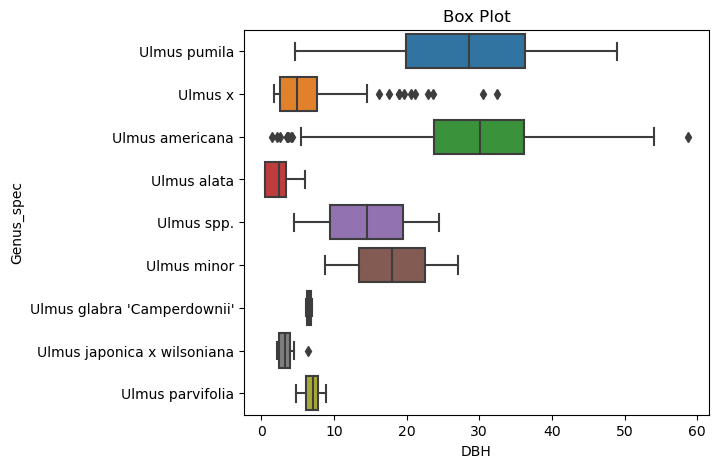

In [141]:
plt.figure(figsize=(6, 5))
sns.boxplot(data=park_trees_df.loc[park_trees_df["Genus"]=="Ulmus"], x='DBH', y='Genus_spec')
plt.title('Box Plot')
plt.show()

**G4: Combine Graphs 1 and 3 into a single figure. Do not plot a legend for any of the graphs.**

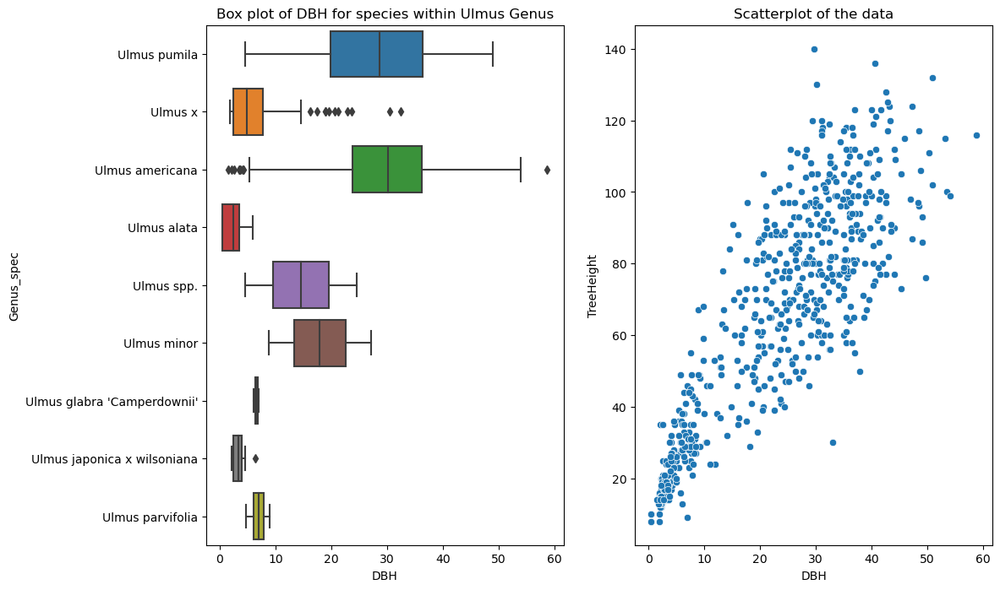

In [208]:
import matplotlib.pyplot as plt
import seaborn as sns

#creating a figure with two sub-plots beside each other
fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(12, 8))

#plotting scatterplot the right subplot
sns.boxplot(data=park_trees_df.loc[park_trees_df["Genus"]=="Ulmus"], x='DBH', y='Genus_spec', ax=ax1)
ax1.set_title('Box plot of DBH for species within Ulmus Genus')          
    
#plotting boxplot the left subplot
sns.scatterplot(data=park_trees_df.loc[park_trees_df["Genus"]=="Ulmus"], x='DBH', y='TreeHeight', ax=ax2)
ax2.set_title('Scatterplot of the data')

#print sub-plots
plt.show()

## Python GeoPandas

In [156]:
import geopandas as gpd
import pandas as pd 

**Task 1: Read the selected dataset as GeoPandas DataFrame**

In [145]:
gullies_geo = gpd.read_file('Gullies/Gullies.shp')

**T2: Use the correct code to plot the first 5 and the last 5 sets of records in your selected dataset.**

<AxesSubplot: >

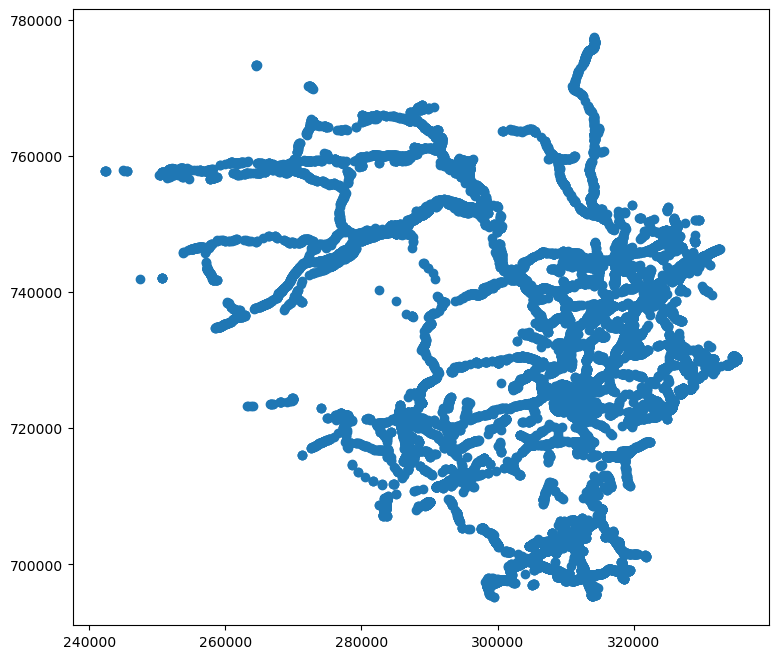

In [146]:
gullies_geo.plot()

In [185]:
gullies_geo

,FID,ITEM_ID,USRN,GULLY_TYPE,geometry
0,1,1909bm033,0,Top Entry (cast iron),POINT (286750.270 717027.680)
1,2,44816,30006086,Top Entry (double triangle),POINT (283553.000 708248.000)
2,3,44828,30006086,Top Entry (double triangle),POINT (283624.000 708817.000)
3,4,44825,30006086,Top Entry (double triangle),POINT (283611.000 708717.000)
4,5,44822,30006086,Top Entry (double triangle),POINT (283588.000 708528.000)
...,...,...,...,...,...
45326,45327,46077,30007310,Top Entry (hinged),POINT (257489.000 743058.000)
45327,45328,46078,30007310,Top Entry (hinged),POINT (258478.000 741763.000)
45328,45329,46079,30007310,Top Entry (hinged),POINT (258770.000 741805.000)
45329,45330,46084,30002648,Top Entry (cast iron),POINT (334631.000 730092.000)


**T3. Create a map where you can explore the selected dataset. Try to plot the map using some categorical attribute. Include a ToolTip.**

In [154]:
gullies_geo.explore(column='GULLY_TYPE', cmap='RdYlBu')

**T4. What is the Coordinate Reference System of the selected dataset?**

In [149]:
gullies_geo.crs

<Derived Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.0, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

**T5. How many features does the selected dataset contain?**

In [150]:
print(len(gullies_geo))

45331


**T6. Define a sub-setting criterion to create a new geopandas dataframe where you filter the selected dataset based on a categorical attribute.**

In [179]:
cat_gullies_geo = gullies_geo[gullies_geo["GULLY_TYPE"]=="Top Entry (hinged)"]
cat_gullies_geo

,FID,ITEM_ID,USRN,GULLY_TYPE,geometry
13,14,44809,30006086,Top Entry (hinged),POINT (283509.000 707902.000)
28,29,44803,30006086,Top Entry (hinged),POINT (283513.000 707901.000)
36,37,26256,30007350,Top Entry (hinged),POINT (296846.000 739623.000)
37,38,26253,30007350,Top Entry (hinged),POINT (296749.000 739667.000)
38,39,26150,30007350,Top Entry (hinged),POINT (297385.000 739638.000)
...,...,...,...,...,...
45260,45261,46075,30000688,Top Entry (hinged),POINT (312815.000 726679.000)
45323,45324,46081,30007307,Top Entry (hinged),POINT (272265.000 745428.000)
45326,45327,46077,30007310,Top Entry (hinged),POINT (257489.000 743058.000)
45327,45328,46078,30007310,Top Entry (hinged),POINT (258478.000 741763.000)


T7. Define a sub-setting criterion to create a new geopandas dataframe where you filter the selected dataset based on a numerical attribute.

In [180]:
cat_gullies_geo = gullies_geo[gullies_geo["USRN"] > 30007310]
cat_gullies_geo

,FID,ITEM_ID,USRN,GULLY_TYPE,geometry
35,36,26170,30007350,Top Entry (double triangle),POINT (296591.000 739690.000)
36,37,26256,30007350,Top Entry (hinged),POINT (296846.000 739623.000)
37,38,26253,30007350,Top Entry (hinged),POINT (296749.000 739667.000)
38,39,26150,30007350,Top Entry (hinged),POINT (297385.000 739638.000)
39,40,26157,30007350,Top Entry (hinged),POINT (296940.000 739588.000)
...,...,...,...,...,...
45316,45317,46055,30007506,Top Entry (double triangle),POINT (304428.000 727931.000)
45317,45318,46056,30007506,Top Entry (double triangle),POINT (304427.000 727900.000)
45318,45319,46057,30007506,Top Entry (double triangle),POINT (304422.000 727794.000)
45320,45321,46049,30007344,Catchpit,POINT (289726.000 752663.000)


T8. Plot the new/filtered geopandas dataframe using one of the attributes to create a choropleth map.

## Python Rasterrio

In [38]:
import rasterio as rio
from rasterio import plot

**Task 1. Read the file as a rasterio dataset**

In [32]:
# reading the file 
elev_geo = rio.open('elev.tif')

**T2: What is the CRS of the dataset?**

In [33]:
# crs
print(elev_geo.crs)

EPSG:32617


**T3: Describe the raster dataset regarding the raster extent (bounds), the reference system, and how many bands are in this dataset.**

In [39]:
# describing the raster data set, reference system and bands
print(elev_geo.bounds)
print(elev_geo.count)

BoundingBox(left=479753.39945587853, bottom=4170823.2037591375, right=668843.3994558785, top=4347733.203759138)
1


**T4: Create a plot/map of the raster dataset.**

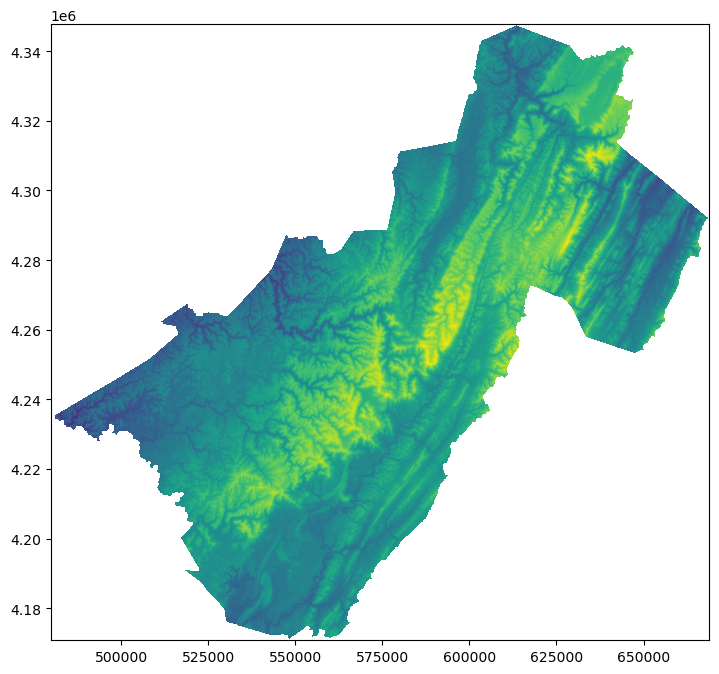

<AxesSubplot: >

In [166]:
from rasterio.plot import show
show(elev_geo)

**T5: Create Histograms from the raster.**

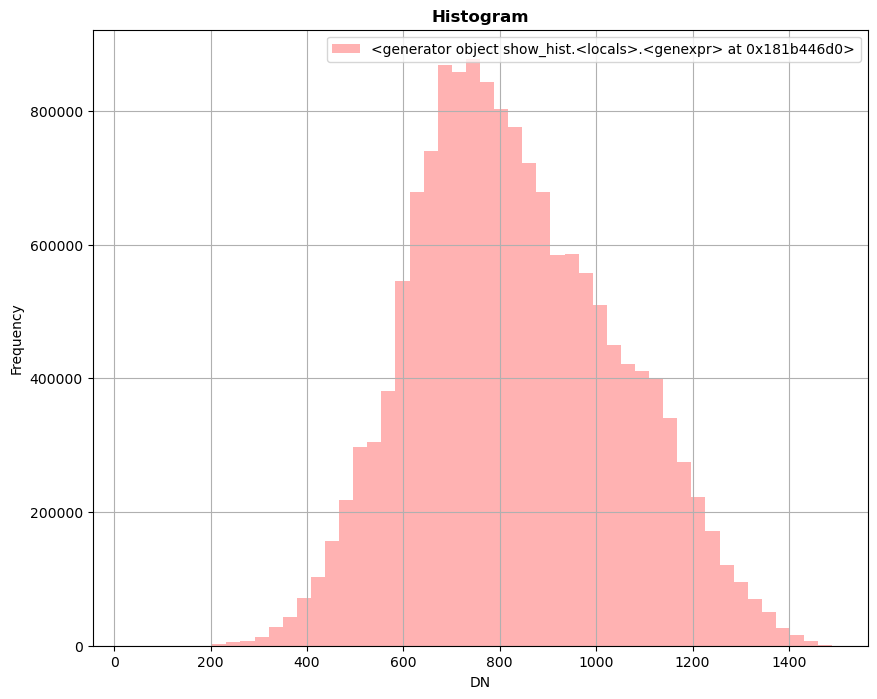

In [205]:
from rasterio.plot import show_hist

show_hist(elev_geo, bins=50, lw=0.0, stacked=False, alpha = 0.3,
         histtype='stepfilled', title='Histogram')